# Text mining project - EDA and pre processing

Done by:
- Ana Farinha | 20211514
- Ana Reis | 20211631
- Beatriz Barreto | 20211547
- Mariana Neto | 20211527

### <font color='#e0218a'>Table of Contents </font> <a class="anchor" id='toc'></a> 
- [0. Import Libraries and Data](#P0)
    - [Import Necessary Libraries](#P0.1)
    - [Import Dataset](#P0.2)
    - [Check ID Duplicates](#P0.3)
- [1. Explore the Dataset](#P1)
    - [Summary Statistics](#P1.1)
    - [Visualizations](#P1.2)
- [2. Pre-processing](#P2)
    - [Textual Corpus Exploration](#P2.1)
    - [Check what aren't songs](#P2.2)
    - [Data pre processing](#P2.3)
        - [Square brackets](#P2.3.1)
        - [Round brackets](#P2.3.2)
        - [Apostrophes](#P2.3.3)
        - [URL](#P2.3.4)
        - [Line Breaks](#P2.3.5)
        - [Italic](#P2.3.6)
        - [Final transformations](#P2.3.7)
- [3. Export the Data](#P3)
- [4. Word Clouds](#P4)

### <font color='#e0218a'>0. Import Libraries and Data</font> <a class="anchor" id="P0"></a>
  [Back to TOC](#toc)
  
  
In this step we will import the necessary libaries, our shortcuts with the functions we made and the dataset. We will also check if we can use an column of the dataset as index.

### Import necessary libraries and shortcuts <a class="anchor" id="P0.1"></a>

[Back to TOC](#toc)

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os
#Preprocessing: tokenization, lemmatization, and stop words removal
import re
# Progress Bar
from tqdm import tqdm
tqdm.pandas()
from wordcloud import WordCloud

# Import preprocessing functions from shortcuts.py
import shortcuts

### Import dataset <a class="anchor" id="P0.2"></a>

[Back to TOC](#toc)

In [2]:
# Define the path and import the dataset
path = "./data_updated/"
train_data = pd.read_csv(path + "train.csv")

In [3]:
train_data

,title,tag,artist,year,views,features,lyrics,id
0,Walk Away,rock,Tony Molina,2013,699,{},When you said you loved me\nDid you mean it th...,535805
1,Gotta Make It Kid Naruto Rap,rap,Reece Lett,2021,4,{Sl!ck},Kid Naruto Rap\n[Hook]\nEverybody wants you to...,7519483
2,​this is what i asked for,pop,Elliot (DNK),2019,389,{},[Verse 1]\nPeople tell me I've changed\nI find...,4892808
3,Stealing Hearts,pop,Katie Armiger,2013,126,{},You've been warned about me\nDon't try to get ...,1584150
4,Get Ready,country,John Campbell Munro,1,2,{},[Verse 1]\nI can see the end is coming but I’v...,7639050
...,...,...,...,...,...,...,...,...
134962,Manhattan,pop,Tijuana Sweetheart,2007,48,{},If I knew when I was young that I'd be older\n...,1702980
134963,Belly Shit,rap,Lil Gotit,2019,3593,"{""Lil Troup""}",[Intro: Lil Gotit]\nCash\nWah-wah-wah\nWah-wah...,4802970
134964,The Four Loves,rock,Heath McNease,2014,301,{},[Verse 1]\nI was born inside a home\nThe young...,403929
134965,Ball And Chain,pop,Transmatic,2001,46,{},Rollin' by the pool the falling stars are not ...,1000723


### Check ID duplicates <a class="anchor" id="P0.3"></a>

[Back to TOC](#toc)

In [4]:
# Check if the id column has any duplicated values
train_data["id"].duplicated().any()

False

Since there are no duplicates on the `id`  we can set it as the index.

In [5]:
# Set the 'id' column as the index
train_data.set_index("id", inplace=True)

In [6]:
train_data

,title,tag,artist,year,views,features,lyrics
id,,,,,,,
535805,Walk Away,rock,Tony Molina,2013,699,{},When you said you loved me\nDid you mean it th...
7519483,Gotta Make It Kid Naruto Rap,rap,Reece Lett,2021,4,{Sl!ck},Kid Naruto Rap\n[Hook]\nEverybody wants you to...
4892808,​this is what i asked for,pop,Elliot (DNK),2019,389,{},[Verse 1]\nPeople tell me I've changed\nI find...
1584150,Stealing Hearts,pop,Katie Armiger,2013,126,{},You've been warned about me\nDon't try to get ...
7639050,Get Ready,country,John Campbell Munro,1,2,{},[Verse 1]\nI can see the end is coming but I’v...
...,...,...,...,...,...,...,...
1702980,Manhattan,pop,Tijuana Sweetheart,2007,48,{},If I knew when I was young that I'd be older\n...
4802970,Belly Shit,rap,Lil Gotit,2019,3593,"{""Lil Troup""}",[Intro: Lil Gotit]\nCash\nWah-wah-wah\nWah-wah...
403929,The Four Loves,rock,Heath McNease,2014,301,{},[Verse 1]\nI was born inside a home\nThe young...


### <font color='#e0218a'>1. Exploring the dataset</font> <a class="anchor" id="P1"></a>
  [Back to TOC](#toc)
  
To better understand the data we are working with we decided to do some exploratory data analysis (EDA). We will check some summary statistics and do some visualizations, like pie charts and bar charts.

### Summary Statistics <a class="anchor" id="P1.1"></a>

[Back to TOC](#toc)

In [7]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 134967 entries, 535805 to 6177674
Data columns (total 7 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   title     134965 non-null  object
 1   tag       134967 non-null  object
 2   artist    134967 non-null  object
 3   year      134967 non-null  int64 
 4   views     134967 non-null  int64 
 5   features  134967 non-null  object
 6   lyrics    134967 non-null  object
dtypes: int64(2), object(5)
memory usage: 8.2+ MB


The only numerical variables are `year` and `views`.

In [8]:
train_data.describe()

,year,views
count,134967.000000,1.349670e+05
mean,2009.467537,3.413344e+03
std,46.287743,4.192449e+04
min,1.000000,0.000000e+00
25%,2008.000000,2.200000e+01
50%,2015.000000,8.900000e+01
75%,2019.000000,4.730000e+02
max,2024.000000,3.604497e+06


We can see that 1 is the minimum value present in the year column and the maximum is 2024. This can be seen as an anomalie in the dataset since we are still in 2023. 

In [9]:
# Search for missing data
train_data.isna().sum()

title       2
tag         0
artist      0
year        0
views       0
features    0
lyrics      0
dtype: int64

In [10]:
# See which rows don't have a title
train_data[train_data.isna().any(axis=1)]

,title,tag,artist,year,views,features,lyrics
id,,,,,,,
7081034,NaN,pop,Las Aves,2019,9,{},There's something more\nIn this life for me an...
4701034,NaN,rock,Josh Gauton,2019,81,{},Let the waves crash over me\nMy sin [?] by lov...


There are only missing values on the `title`.

Since we want to predict the `tag` let's see what tags we have.

In [11]:
train_data.tag.unique()

array(['rock', 'rap', 'pop', 'country', 'rb', 'misc'], dtype=object)

### Visualizations <a class="anchor" id="P1.2"></a>

[Back to TOC](#toc)

In [12]:
tag_counts = train_data['tag'].value_counts().sort_index()

# Create a pie chart for the percentages of each tag
fig = px.pie(names = tag_counts.index,
            values = tag_counts.values,
            color_discrete_sequence = ['#e0218a','#ACDCFF','#B288EA','#B91617','#FEBC42','#92E386'],
            title = 'Percentages of each tag')

# Show the graph
fig.show()

In [13]:
# Plotting a bar chart for number of songs in each tag
fig = px.bar(x = tag_counts.index,
            y = tag_counts.values,
            title = 'Number of observations in each tag',
            labels={'x': 'Tags', 'y':'Number of songs in each tag'})

# Choose the bar colour
fig.update_traces(marker_color = '#e0218a')

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Order the columns
fig.update_layout(xaxis={'categoryorder':'total descending'})

# Show the graph
fig.show()

In [14]:
count_artist =train_data['artist'].value_counts().reset_index()
result = count_artist[count_artist['count']>30]

# Plotting a bar chart for number of songs in each tag
fig = px.bar(x = result['artist'],
            y = result['count'],
            title = 'Artists with more than 30 songs and how many',
            labels={'x': 'Artists', 'y':'Number of songs of each artist'})

# Choose the bar colour
fig.update_traces(marker_color = '#e0218a')

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show the graph
fig.show()

Seeing as *Genious English Translations* has significantly more songs than the other artists, we decided to see what those songs were.

In [15]:
train_data[train_data['artist'] == 'Genius English Translations'].head()

,title,tag,artist,year,views,features,lyrics
id,,,,,,,
6815917,Ferbinho - Lionel English Translation,rap,Genius English Translations,2021,6,{},[Intro]\nSOSICK\nAhn\n\n[Verse 1]\nI'm in the ...
7634567,Def. - WANT U English Translation,rb,Genius English Translations,2022,2140,{},[Intro]\nLove you\nI just need you\nAnd I want...
7550031,Sogumm 소금 Dress - Honey bee ft. PENOMECO 페노메코 ...,pop,Genius English Translations,2019,31,{},[Intro: sogumm]\nBeautiful\nI never seen any b...
7749379,Ricky Martin - Náufrago English Translation,pop,Genius English Translations,2015,6,{},"[Intro]\nI have a story for you, ha!\n\n[Verse..."
7366990,Coogie - Swipe Feat. Ourealgoat Touch the Sky...,rap,Genius English Translations,2021,18,{},[Chorus]\nGimme the loot\nSwiping fuck boys to...


As we can see *Genious English Translations* has songs translated into english.

In [16]:
count_ft =train_data['features'].value_counts().reset_index()
result = count_ft[(count_ft['features'] != '{}') & (count_ft['count'] > 15)]

# Plotting a bar chart for number of songs in each tag
fig = px.bar(x = result['features'],
            y = result['count'],
            title = 'Artists featured in more than 15 songs',
            labels={'x': 'Artists', 'y':'Number of features'})

# Choose tha br colour
fig.update_traces(marker_color = '#e0218a')

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show the graph
fig.show()

In [17]:
count_vs = train_data.groupby('artist')['views'].sum().reset_index().sort_values(by='views',ascending=False).head(20)

# Plotting a bar chart for number of views per artist
fig = px.bar(x = count_vs['artist'],
            y = count_vs['views'],
            title = '20 artists with more views',
            labels={'x': 'Artists', 'y':'Number of views'})

# Choose tha br colour
fig.update_traces(marker_color = '#e0218a')

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show the graph
fig.show()

Even though these are the artists with more views, not every artsist has the same amount of songs in the dataframe. theresfore, let's plot a bar chart with the average views instead of the sum.

In [18]:
count_vs = train_data.groupby('artist')['views'].mean().reset_index().sort_values(by='views',ascending=False).head(20)

# Plotting a bar chart for number of songs in each tag
fig = px.bar(x = count_vs['artist'],
            y = count_vs['views'],
            title = '20 artists with more views in average',
            labels={'x': 'Artists', 'y':'Number of views'})

# Choose tha br colour
fig.update_traces(marker_color = '#e0218a')

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show the graph
fig.show()

As we can see the artists differ a lot between the two graphs.

In [19]:
data = train_data['year'].value_counts().reset_index()
data.columns = ['year', 'count']

# Ploting an interactive bar chart for the numbere of songs released in each year
fig = px.bar(data, x='year', y='count', title='Number of songs released in each year')

# Choose the color of the bars
fig.update_traces(marker={'color':'#e0218a'})

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show figure
fig.show()

With this interactive bar chart we can see that there are a lot of years with songs released, however there is an exponentian increase in late 1940's.

In [20]:
# Ploting an interactive bar chart for the numbere of songs released in each year
fig = px.histogram(train_data, x='year', title='Distribution of songs per tag through the years', 
                   animation_frame='tag', color_discrete_sequence=['#e0218a'])

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show figure
fig.show()

### <font color='#e0218a'>2. Text Preprocessing</font> <a class="anchor" id="P2"></a>
  [Back to TOC](#toc)
  
In order to train our model pre processing needs to be done.

In [21]:
# Convert the lyrics into a string
train_data['lyrics'] = train_data['lyrics'].astype(str)

To pre process our text we need to see what we are working with, in order to make decisions on what to change and delete.

In [22]:
# Select a random sample from the lyrics
train_data['lyrics'].sample(1).iloc[0]

"[Spoken: Ryan's Mom]\nHey Ry, it's mom\nIf you didn’t know\nIt's so crazy to think you're a man now\nWith a wife and kids of your own and\nI’m just so proud of the man you've become\nNow, you have your own little boys\nIt's gonna be a crazy, fun ride\nIt already is, isn't it?\nBut do you remember I took you and your brother to a live Power Rangers concert\nAnd I remember how fixated you were\nWhen you were watching all the Power Rangers do all their um, acrobatics\nBack-hand springs and stuff\nAnd when we got home, you rushed to get your Power Ranger figurines out\nAnd you started to reenact the concert\nAll of a sudden, you just did a back-hand spring\nI couldn't believe it\nOut of nowhere\nI guess, you know you were just inspired enough\nAnd fearless enough to just do it\nOne thing about you, you never back down from a challenge\nYou always, you always took them on\nYou tried, you tried everything\nYou tried ballet, you got a scholarship for ballet\nYou tried boy's hula\nYou tried t

### Textual Corpus Exploration <a class="anchor" id="P2.1"></a>

[Back to TOC](#toc)

In [23]:
# Interview
# train_data['lyrics'].loc[356439]

In [24]:
# Book chapter
# train_data['lyrics'].loc[158521]

Check size, number of new line and existence of html

In [25]:
# Check length of lyrics
train_data['lyrics_len'] = train_data['lyrics'].apply(len)

# See if there is html and url
regex_html_pattern = '(\\.|<\w>|<\/\w>|\bhttp[^\s]+\b|\bwww\.[^\s]+\b)'

train_data["Has_regex_html"] = train_data["lyrics"].apply(
    lambda lyrics: 0 if (re.match(regex_html_pattern, str(lyrics)) is None) else 1)

# See how many new lines there are
train_data["new_line_count"] = train_data["lyrics"].apply(lambda lyrics: str(lyrics).count('\n'))

# Summary statistics including our new variables
train_data.describe()

,year,views,lyrics_len,Has_regex_html,new_line_count
count,134967.000000,1.349670e+05,134967.000000,134967.000000,134967.000000
mean,2009.467537,3.413344e+03,1628.686212,0.000437,48.777101
std,46.287743,4.192449e+04,2539.645922,0.020903,42.542624
min,1.000000,0.000000e+00,100.000000,0.000000,0.000000
25%,2008.000000,2.200000e+01,806.000000,0.000000,28.000000
50%,2015.000000,8.900000e+01,1233.000000,0.000000,43.000000
75%,2019.000000,4.730000e+02,1900.000000,0.000000,62.000000
max,2024.000000,3.604497e+06,103398.000000,1.000000,3823.000000


In [26]:
# See the mean of our new variables per each tag
train_data.groupby('tag')[['lyrics_len', 'Has_regex_html', 'new_line_count']].agg('mean')

,lyrics_len,Has_regex_html,new_line_count
tag,,,
country,1166.441431,0.000000,38.333237
misc,5483.941844,0.001241,66.907447
pop,1144.972893,0.000431,41.488519
rap,2209.081459,0.000415,63.191297
rb,1530.093181,0.000161,54.941480
rock,1038.099163,0.000434,38.743486


In [27]:
# Create a boxplot for the length of the lyrics in each tag
fig = px.box(train_data, x='lyrics_len', y='tag', title='Distribution of length of lyrics per tag')

# Choose the color of the bars
fig.update_traces(marker={'color':'#e0218a'})

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show the plot
fig.show()

In [28]:
# Create a boxplot for the number of new lines in each tag
fig = px.box(train_data, x='new_line_count', y='tag', title='Distribution of new lines in each tag')

# Choose the color of the bars
fig.update_traces(marker={'color':'#e0218a'})

# Choose a background color
fig.update_layout(plot_bgcolor='#f5f3f4')

# Show the plot
fig.show()

### Check and drop what isn't songs <a class="anchor" id="P2.2"></a>

[Back to TOC](#toc)

In [29]:
# Create a function that checks if a lyric has "Lyrics", "song", "music", "verse" or "chorus"
def contains_lyrics(text):
    regex = re.compile(r'\b(Lyrics|song|music|verse|chorus)\b', flags=re.IGNORECASE)
    return bool(re.search(regex, text))

In [30]:
# Apply the function to create a mask indicating if a row contains lyrics
mask = ((train_data['tag'] == 'rock') &
        (train_data['new_line_count'] > 700))

# Delete rows from the original DataFrame where tag is 'rock' and don't contain lyrics
train_data.drop(train_data[mask].index, inplace=True)

In rock music, we did not remove smaller text because there are some songs that are mainly instrumental.

In [31]:
# Apply the function to create a mask indicating if a row contains lyrics
mask = ((train_data['tag'] == 'rap') &
        (train_data['lyrics_len'] > 35000) &
        (~train_data['lyrics'].apply(contains_lyrics)))

# Delete rows from the original DataFrame where tag is 'rap' and don't contain lyrics
train_data.drop(train_data[mask].index, inplace=True)

In rap music, we did not remove smaller text because we found small songs with no line breaks.

We also did not find any anomalies on pop and country songs.

In [32]:
# Apply the function to create a mask indicating if a row contains lyrics
mask = ((train_data['tag'] == 'rb') & (
        (train_data['lyrics_len'] > 10000) |
        ((train_data['lyrics_len'] < 150) &
        (train_data['new_line_count'] == 0))))

# Delete rows from the original DataFrame where tag is 'rb' and don't contain lyrics
train_data.drop(train_data[mask].index, inplace=True)

In [33]:
# Apply the function to create a mask indicating if a row contains lyrics
mask = ((train_data['tag'] == 'misc') & 
        (~train_data['lyrics'].apply(contains_lyrics)) & (
        (train_data['title'].apply(lambda title: bool(re.search(r'\b(chapter|chap|interview|week|list|essay|season|episode|guide|full text|research project)\b', str(title).lower())))) |
        (train_data['artist'].apply(lambda title: bool(re.search(r'\b(foundation|research|elections|abraham lincoln|archives)\b', str(title).lower())))) |
        ((train_data['new_line_count'] < 8)) |
        ((train_data['lyrics_len'] > 2000) &
        (train_data['new_line_count'] > 65))))

# Delete rows from the original DataFrame where tag is 'misc' and don't contain lyrics
train_data.drop(train_data[mask].index, inplace=True)

In [34]:
train_data = train_data.drop(columns = ['lyrics_len', 'Has_regex_html', 'new_line_count'])

In [35]:
train_data.shape

(133243, 7)

### Data pre processing <a class="anchor" id="P2.3"></a>

[Back to TOC](#toc)

#### 1. Square Brackets <a class="anchor" id="P2.3.1"></a>

[Back to TOC](#toc)

In [36]:
pattern = r'\[([^\]]+)\]'

In [37]:
train_data['lyrics'].apply(lambda lyrics: re.findall(pattern, lyrics))

id
535805                                                    []
7519483            [Hook, Verse, Hook, Verse 2: SL!CK, Hook]
4892808                   [Verse 1, Chorus, Verse 2, Chorus]
1584150                                                   []
7639050    [Verse 1, Chorus, Verse 2, Chorus, Verse 3, Ch...
                                 ...                        
1702980                                                   []
4802970    [Intro: Lil Gotit, Chorus: Lil Troup & Lil Got...
403929     [Verse 1, Interlude 1, Verse 2, Interlude 2, V...
1000723                                                   []
6177674    [Verse 1: GodlyRiskTaker A, Chorus: GodlyRiskT...
Name: lyrics, Length: 133243, dtype: object

In [38]:
shortcuts.extract_and_remove_square_brackets(train_data, 'lyrics', False)

#### 2. Round Brackets <a class="anchor" id="P2.3.2"></a>

[Back to TOC](#toc)

In [39]:
show = False

In [40]:
# Extract content between round brackets
extracted_content = train_data['lyrics'].str.extract(r'\(([^)]+)\)')

# Combine all extracted content into a single list
content_list = extracted_content.stack().tolist()

# Find unique strings in the list
unique_strings = set(content_list)

if show:
    print("Unique strings in the extracted content:")
    print(unique_strings)

In [41]:
# Remove round brackets but not text within
train_data['lyrics'] = train_data['lyrics'].map(lambda s: re.sub(r'\(|\)', '', s))

#### 3. Apostrophes <a class="anchor" id="P2.3.3"></a>

[Back to TOC](#toc)

In [42]:
# Change all types of apostrophes to the same one - '
train_data['lyrics'] = train_data['lyrics'].apply(lambda content: shortcuts.apostrophe_substitution(content))

#### 4. URL <a class="anchor" id="P2.3.4"></a>

[Back to TOC](#toc)

In [43]:
# # Example with URL
# test = train_data['lyrics'].iloc[4037]
# test

In [44]:
# Remove URL
shortcuts.remove_url(train_data, 'lyrics')

In [45]:
# test

#### 5. Line Breaks <a class="anchor" id="P2.3.5"></a>

[Back to TOC](#toc)

In [46]:
# # Example with line breaks
# test = train_data['lyrics'].loc[5659885]
# test

In [47]:
# # Remove isolated consonants:
# test = re.sub(r'\b([^aeiou])\b', ' ', test, flags=re.IGNORECASE)

# # Remove newline characters
# test = re.sub(r'(\n|\r|\t|</ul>)', ' ', test)
# test

#### 6. Italics <a class="anchor" id="P2.3.6"></a>

[Back to TOC](#toc)

In [48]:
# # Example with italics
# test = train_data['lyrics'].loc[6505851]
# test

In [49]:
# # Remove italics
# unicodedata.normalize('NFKD', test).encode('ascii', 'ignore').decode('utf-8')

#### 7. Final Transformations<a class="anchor" id="P2.3.7"></a>

[Back to TOC](#toc)

In this function we remove italics, line breaks and isolated consonants. We also create two different columns that have the lyrics preprocesssed in different ways.

In [50]:
# Reset index
train_data.reset_index(drop=True, inplace=True)

In [51]:
# Lowercase, remove ponctuation, remove stopwords, correct spelling, lemmatization, tokenization 
train_data['preprocessed_lyrics'] = train_data['lyrics'].progress_apply(lambda content: shortcuts.preprocessor(content,
                                                                                                               lowercase=True, 
                                                                                                               leave_punctuation = False, 
                                                                                                               remove_stopwords = True,
                                                                                                               correct_spelling = False, 
                                                                                                               lemmatization=False, 
                                                                                                               tokenized_output=False, 
                                                                                                               sentence_output=False
                                                                                                               ))

100%|██████████| 133243/133243 [03:39<00:00, 607.99it/s]


<br>

In [52]:
# Preprocessing for the sentiment analysis
train_data['sa_lyrics'] = train_data['lyrics'].progress_apply(lambda content : shortcuts.preprocessor(content,
                                                                                                       lowercase=False, 
                                                                                                       leave_punctuation = True, 
                                                                                                       remove_stopwords = False,
                                                                                                       correct_spelling = False, 
                                                                                                       lemmatization=False, 
                                                                                                       tokenized_output=False, 
                                                                                                       sentence_output=False
                                                                                                       ))

100%|██████████| 133243/133243 [03:35<00:00, 619.21it/s]


In [53]:
train_data

,title,tag,artist,year,views,features,lyrics,preprocessed_lyrics,sa_lyrics
0,Walk Away,rock,Tony Molina,2013,699,{},When you said you loved me\nDid you mean it th...,said loved mean change mind day pretend walk a...,When you said you loved me Did you mean it the...
1,Gotta Make It Kid Naruto Rap,rap,Reece Lett,2021,4,{Sl!ck},Kid Naruto Rap\n\nEverybody wants you to hurt\...,kid naruto rap everybody wants hurt everybody ...,Kid Naruto Rap Everybody wants you to hurt Eve...
2,​this is what i asked for,pop,Elliot (DNK),2019,389,{},\nPeople tell me I've changed\nI find it hard ...,people tell changed find hard maybe feel make ...,People tell me I have changed I find it hard t...
3,Stealing Hearts,pop,Katie Armiger,2013,126,{},You've been warned about me\nDon't try to get ...,warned try get close want chain leave ghost to...,You have been warned about me Do not try to ge...
4,Get Ready,country,John Campbell Munro,1,2,{},\nI can see the end is coming but I've never l...,end coming never liked odds need way even deal...,I can see the end is coming but I have never l...
...,...,...,...,...,...,...,...,...,...
133238,Manhattan,pop,Tijuana Sweetheart,2007,48,{},If I knew when I was young that I'd be older\n...,knew young would older many things would told ...,If I knew when I was young that I would be old...
133239,Belly Shit,rap,Lil Gotit,2019,3593,"{""Lil Troup""}",\nCash\nWah-wah-wah\nWah-wah-wah\nEverything i...,cash wah wah wah wah wah wah everything chrome...,Cash Wah wah wah Wah wah wah Everything is chr...
133240,The Four Loves,rock,Heath McNease,2014,301,{},\nI was born inside a home\nThe youngest of th...,born inside home youngest three boys fought da...,I was born inside a home The youngest of the t...
133241,Ball And Chain,pop,Transmatic,2001,46,{},Rollin' by the pool the falling stars are not ...,rollin pool falling stars condescending twins ...,Rollin' by the pool the falling stars are not ...


### <font color='#e0218a'>3. Exporting the data</font> <a class="anchor" id="P3"></a>
  [Back to TOC](#toc)

Now we need to export our preprocessed data to be used in further steps.

In [54]:
train_data.to_csv(path + 'preprocesssed_data.csv', index = False)

### <font color='#e0218a'>4. Word Clouds </font> <a class="anchor" id="P4"></a>
  [Back to TOC](#toc)

Here, we are going to check the most frequent words by tag using Word Clouds.

In [55]:
def generate_wordcloud(data, genre):
    # Concatenate all documents for the specified genre
    documents = data[data['tag'] == genre]['preprocessed_lyrics'].values

    # Join the documents into a single string
    text = ' '.join(documents)

    wordcloud = WordCloud(width=800, height=400, background_color='white',colormap=sns.color_palette("blend:#ACDCFF,#e0218a", as_cmap=True)).generate(text)
    title = f'Word Cloud - {genre}'

    # Plot the WordCloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(title)
    plt.axis('off')

    # Save the WordCloud as a PNG file
    save_path = os.path.join('wordclouds', f'{genre}__wordcloud.png')
    os.makedirs(os.path.dirname(save_path), exist_ok=True)
    plt.savefig(save_path)
    plt.show()

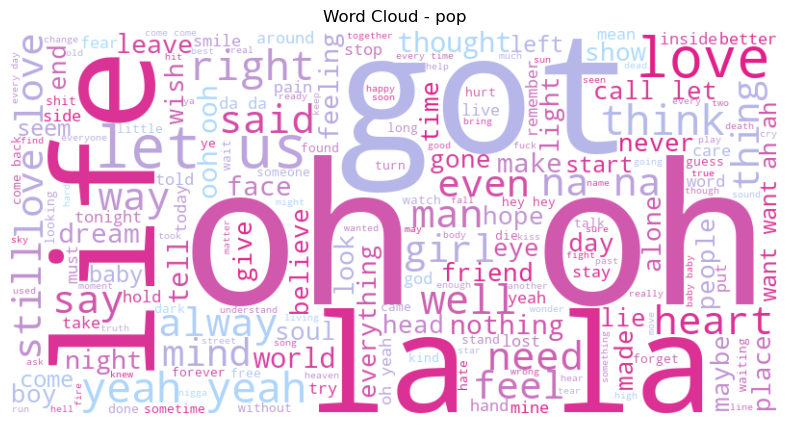

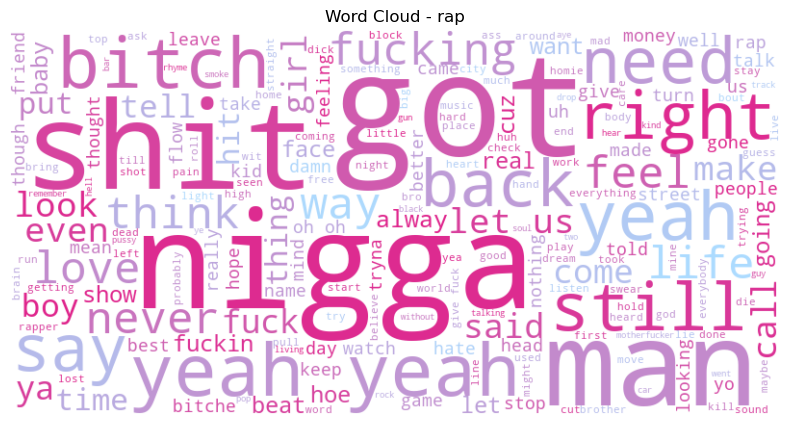

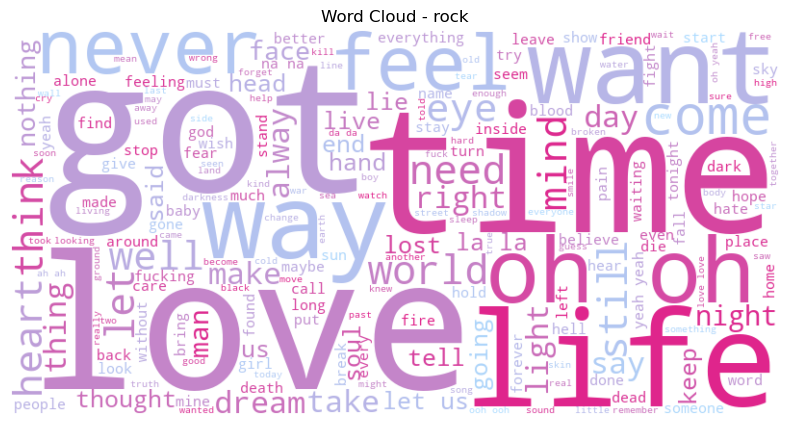

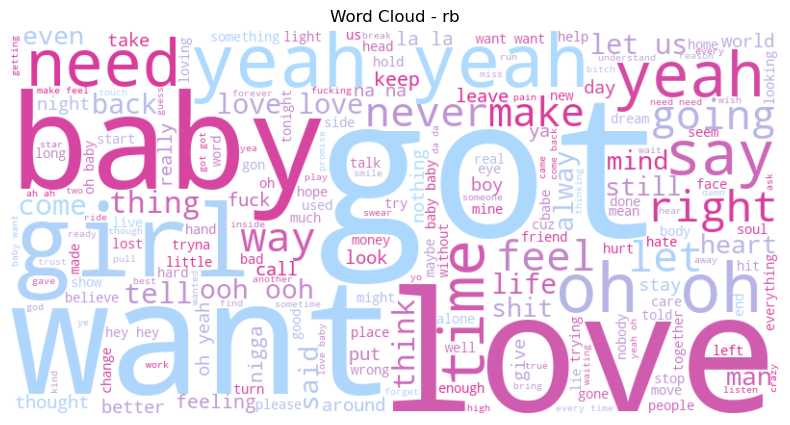

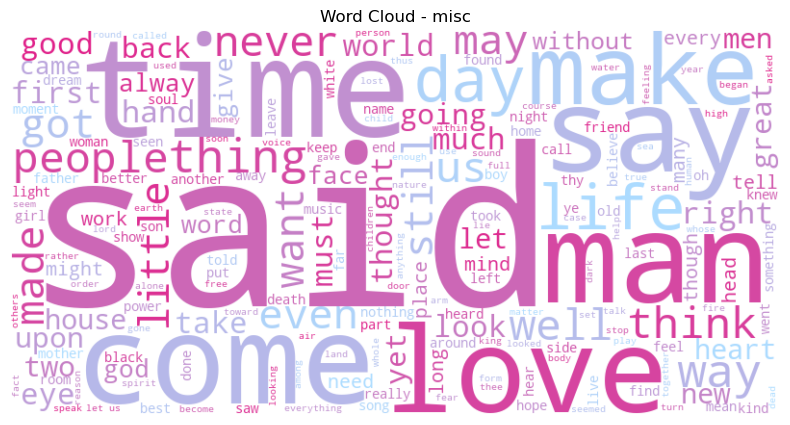

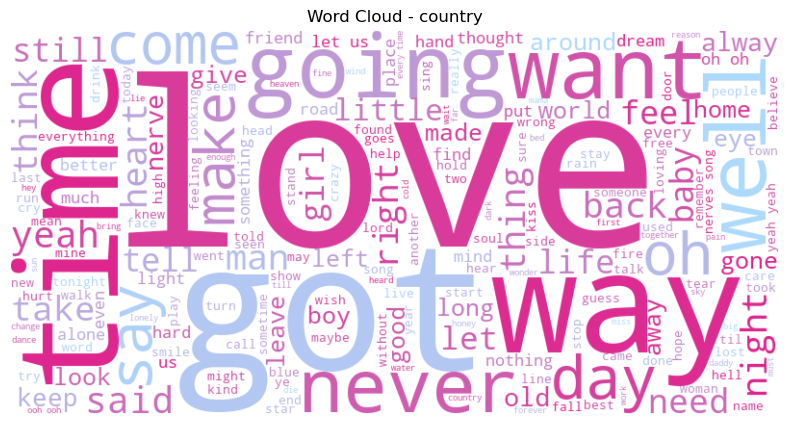

In [56]:
genres = ['pop', 'rap', 'rock', 'rb', 'misc', 'country']
for genre in genres:
    generate_wordcloud(train_data, genre)